# Preprocessing

In [ ]:
!rm -r Stomach
!rm -r dataset

rm: cannot remove 'Stomach': No such file or directory
rm: cannot remove 'dataset': No such file or directory


In [ ]:
"""
!rsync -p ./drive/MyDrive/Stomach.zip .

!rsync -p ./drive/MyDrive/cam.txt .
"""

'\n!rsync -p ./drive/MyDrive/Stomach.zip .\n\n!rsync -p ./drive/MyDrive/cam.txt .\n'

In [ ]:
!unzip Stomach.zip

Archive:  Stomach.zip
   creating: Stomach/Frames/
  inflating: Stomach/Frames/image_0000.png  
  inflating: Stomach/Frames/image_0001.png  
  inflating: Stomach/Frames/image_0002.png  
  inflating: Stomach/Frames/image_0003.png  
  inflating: Stomach/Frames/image_0004.png  
  inflating: Stomach/Frames/image_0005.png  
  inflating: Stomach/Frames/image_0006.png  
  inflating: Stomach/Frames/image_0007.png  
  inflating: Stomach/Frames/image_0008.png  
  inflating: Stomach/Frames/image_0009.png  
  inflating: Stomach/Frames/image_0010.png  
  inflating: Stomach/Frames/image_0011.png  
  inflating: Stomach/Frames/image_0012.png  
  inflating: Stomach/Frames/image_0013.png  
  inflating: Stomach/Frames/image_0014.png  
  inflating: Stomach/Frames/image_0015.png  
  inflating: Stomach/Frames/image_0016.png  
  inflating: Stomach/Frames/image_0017.png  
  inflating: Stomach/Frames/image_0018.png  
  inflating: Stomach/Frames/image_0019.png  
  inflating: Stomach/Frames/image_0020.png  
  in

In [ ]:
import os
import shutil
from PIL import Image
import random
import json

In [ ]:
print(len(os.listdir("./Stomach/Frames")))
print(len(os.listdir("./Stomach/Pixelwise Depths")))

1543
1543


In [ ]:
pixel_path = os.listdir("./Stomach/Pixelwise Depths")
frames_path = os.listdir("./Stomach/Frames")

In [ ]:
print(len(os.listdir("./Stomach/Frames")))
print(len(os.listdir("./Stomach/Pixelwise Depths")))
pixel_path = os.listdir("./Stomach/Pixelwise Depths")
frames_path = os.listdir("./Stomach/Frames")

1543
1543


In [ ]:
def get_id(file_name):
  return file_name.split("_")[-1]

pixel_path_new = list(map(get_id, pixel_path))
frames_path_new = list(map(get_id, frames_path))

try:
  os.mkdir("Stomach/newFrames")
  os.mkdir("Stomach/newPixels")
except:
  pass

for i in range(len(pixel_path)):
  shutil.copy("./Stomach/Frames/{}".format(frames_path[i]), "./Stomach/newFrames/{}".format(frames_path_new[i])  ) 

  shutil.copy("./Stomach/Pixelwise Depths/{}".format(pixel_path[i]), "./Stomach/newPixels/{}".format(pixel_path_new[i])  ) 

pixel_path_new.sort()
frames_path_new.sort()

print(pixel_path_new)
print(frames_path_new)

['0000.png', '0001.png', '0002.png', '0003.png', '0004.png', '0005.png', '0006.png', '0007.png', '0008.png', '0009.png', '0010.png', '0011.png', '0012.png', '0013.png', '0014.png', '0015.png', '0016.png', '0017.png', '0018.png', '0019.png', '0020.png', '0021.png', '0022.png', '0023.png', '0024.png', '0025.png', '0026.png', '0027.png', '0028.png', '0029.png', '0030.png', '0031.png', '0032.png', '0033.png', '0034.png', '0035.png', '0036.png', '0037.png', '0038.png', '0039.png', '0040.png', '0041.png', '0042.png', '0043.png', '0044.png', '0045.png', '0046.png', '0047.png', '0048.png', '0049.png', '0050.png', '0051.png', '0052.png', '0053.png', '0054.png', '0055.png', '0056.png', '0057.png', '0058.png', '0059.png', '0060.png', '0061.png', '0062.png', '0063.png', '0064.png', '0065.png', '0066.png', '0067.png', '0068.png', '0069.png', '0070.png', '0071.png', '0072.png', '0073.png', '0074.png', '0075.png', '0076.png', '0077.png', '0078.png', '0079.png', '0080.png', '0081.png', '0082.png', '00

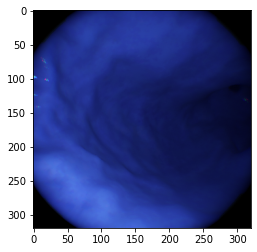

In [ ]:
img_id = 500

import cv2
import matplotlib.pyplot as plt


img_frame = cv2.imread("./Stomach/newFrames/{}".format(frames_path_new[img_id]))

plt.imshow(img_frame)

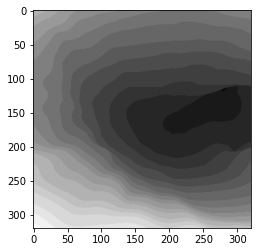

In [ ]:
img_depth = cv2.imread("./Stomach/newPixels/{}".format(pixel_path_new[img_id]))

plt.imshow(img_depth/img_depth.max())

In [ ]:
import random
import shutil

def create_dataset(size, frames, pixels, total_size=1544, seed=42): # size is either 250 or 500
  random.seed(seed)
  try:
    os.mkdir("dataset")
  except Exception as e:
    print("dataset creation")
    print(e)
    pass

  try:
    shutil.rmtree("dataset/size_{}".format(size))
  except Exception as e:
    print("dataset deletion")
    print(e)
    pass

  try:
    os.mkdir("dataset/size_{}".format(size))
    os.mkdir("dataset/size_{}/train".format(size))
    os.mkdir("dataset/size_{}/val".format(size))
    os.mkdir("dataset/size_{}/test".format(size))
  except Exception as e:
    print("sub dataset creation")
    print(e)
    pass

  start_index = random.randint(0, total_size-size)

  for i in range(start_index, start_index+size):
    if i-start_index < size*7/10:
      shutil.copy("Stomach/newFrames/{}".format(frames[i]), "dataset/size_{}/train/".format(size))
    elif i-start_index < size*8/10:
      shutil.copy("Stomach/newFrames/{}".format(frames[i]), "dataset/size_{}/val/".format(size))
    else:
      shutil.copy("Stomach/newFrames/{}".format(frames[i]), "dataset/size_{}/test/".format(size))

  print("Train Size: {}".format(len(os.listdir("dataset/size_{}/train".format(size)))))
  print("Val Size: {}".format(len(os.listdir("dataset/size_{}/val".format(size)))))
  print("Test Size: {}".format(len(os.listdir("dataset/size_{}/test".format(size)))))

  with open("dataset/size_{}/train.txt".format(size), "w+") as trainFile:
    trainFile.write("train/")

  with open("dataset/size_{}/val.txt".format(size), "w+") as valFile:
    valFile.write("val/")

  with open("dataset/size_{}/test.txt".format(size), "w+") as testFile:
    testFile.write("test/")

  shutil.copy("./cam.txt", "dataset/size_{}/train".format(size))
  shutil.copy("./cam.txt", "dataset/size_{}/val".format(size))
  shutil.copy("./cam.txt", "dataset/size_{}/test".format(size))

  return frames[start_index:start_index+size], pixels[start_index:start_index+size]
  

In [ ]:
frames_250, pixels_250 = create_dataset(250, frames_path_new, pixel_path_new, len(frames_path_new), seed=42)
frames_500, pixels_500 = create_dataset(500, frames_path_new, pixel_path_new, len(frames_path_new), seed=42)

dataset deletion
[Errno 2] No such file or directory: 'dataset/size_250'
Train Size: 175
Val Size: 25
Test Size: 50
dataset creation
[Errno 17] File exists: 'dataset'
dataset deletion
[Errno 2] No such file or directory: 'dataset/size_500'
Train Size: 350
Val Size: 50
Test Size: 100


In [ ]:
from PIL import Image

def png2jpg(path):
  png_list = os.listdir(path)

  for png in png_list:
    if png == "cam.txt":
      continue
    jpg_im = Image.open(path+"/"+png).convert("RGB")
    jpg_im.save(path+"/"+png[:-3]+"jpg")
    os.remove(path+"/"+png)

png2jpg("./dataset/size_250/train")
png2jpg("./dataset/size_500/train")

png2jpg("./dataset/size_250/val")
png2jpg("./dataset/size_500/val")
#png2jpg("./Stomach/Pixelwise Depths")

# Repository

In [ ]:
!git clone https://github.com/JiawangBian/SC-SfMLearner-Release.git
%cd SC-SfMLearner-Release/

Cloning into 'SC-SfMLearner-Release'...
remote: Enumerating objects: 280, done.
remote: Total 280 (delta 0), reused 0 (delta 0), pack-reused 280
Receiving objects: 100% (280/280), 2.42 MiB | 22.93 MiB/s, done.
Resolving deltas: 100% (147/147), done.
/content/SC-SfMLearner-Release


In [ ]:
!pip3 install -r requirements.txt

     |████████████████████████████████| 317kB 11.0MB/s 


In [ ]:
!rsync -p ../test_vo.py .

# Models

In [ ]:
# Initialize tensorboard

%load_ext tensorboard 
%tensorboard --logdir ./checkpoints/

<IPython.core.display.Javascript object>

In [ ]:
!rm -r ./checkpoints # clear older checkpoints
!rm -r ./results # clear older results
!rm -r ./vo_results # clear older vo results
!rm -r ./graphs

rm: cannot remove './checkpoints': No such file or directory
rm: cannot remove './results': No such file or directory
rm: cannot remove './vo_results': No such file or directory
rm: cannot remove './graphs': No such file or directory


In [ ]:
rmse_dict = {}

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import math
from skimage import img_as_float
from sklearn.metrics import mean_squared_error as mse
import cv2
import time

In [ ]:
try:
  os.mkdir("graphs")
except:
  pass

In [37]:
def run_config(epochs = 10, lr = 0.0001, datasize=250, resnet = 18):
  
  os.system("rm -r ./checkpoints/s{}_e{}_lr{}".format(datasize, epochs, lr))

  try:
    os.mkdir("graphs/size_{}".format(datasize))
  except:
    pass

  try:
    os.mkdir("graphs/size_{}/e{}_lr{}".format(datasize, epochs, lr))
  except:
    pass

  start = time.time()  
  print("Training started with: Epochs: {}, Datasize: {}, LearningRate: {}, Resnet: {}".format(epochs, datasize, lr, resnet))
  os.system("python train.py '../dataset/size_{}' \
              --resnet-layers {} \
              --num-scales 1 \
              -b4 -s0.1 -c0.5 --epochs {} --sequence-length 3 \
              --lr {} \
              --with-ssim 1 \
              --with-mask 1 \
              --with-auto-mask 1 \
              --with-pretrain 1 \
              --log-output \
              --name s{}_e{}_lr{}".format(datasize, resnet, epochs, lr, datasize, epochs, lr))
  
  os.system("ls ./checkpoints/s{}_e{}_lr{}".format(datasize, epochs, lr))

  print("Testing started...")

  os.system("python test_disp.py --resnet-layers {} --img-height 320 --img-width 320 \
            --pretrained-dispnet ./checkpoints/s{}_e{}_lr{}/*/dispnet_checkpoint.pth.tar \
            --dataset-dir ../dataset/size_{}/test \
            --output-dir results/size_{}/e{}_lr{}".format(resnet, datasize, epochs, lr, datasize, datasize, epochs, lr))
  
  gt_list = os.listdir("../dataset/size_{}/test".format(datasize))
  gt_list.sort()
  ground_truth_grey = []
  gt_colored = []
  for i in gt_list:
    if i == "cam.txt":
      continue
    im_gray = cv2.imread("../Stomach/newPixels/"+i[:-3]+"png",cv2.IMREAD_GRAYSCALE)
    ground_truth_grey.append(im_gray.astype(float))
    im_color = Image.open("../dataset/size_{}/test/".format(datasize)+i).convert("RGB") #cv2.imread("../dataset/size_250/test/"+i)
    gt_colored.append(im_color)

  endosfm_pred_path = "./results/size_{}/e{}_lr{}/predictions.npy".format(datasize, epochs, lr) 
  endosfm_preds = np.load(endosfm_pred_path,allow_pickle=True)

  print("Img: {}, GT: {}, Preds: {}". format(len(gt_colored), len(ground_truth_grey), len(endosfm_preds)))


  for i in range(len(endosfm_preds)):
      plt.figure(figsize=(12, 12))
      
      plt.subplot(131)
      plt.imshow(gt_colored[i])
      plt.title("Input", fontsize=9)
      plt.axis('off')

      plt.subplot(132)
      plt.imshow(ground_truth_grey[i], cmap='magma')
      plt.title("Ground Truth", fontsize=9)
      plt.axis('off')
      
      plt.subplot(133)
      plt.imshow(endosfm_preds[i], cmap='magma')
      plt.title("Predictions", fontsize=9)
      plt.axis('off')
      plt.savefig("graphs/size_{}/e{}_lr{}/preds{}.png".format(datasize, epochs, lr, i))

  
  def rmsdiff(im1, im2):
      """Calculates the root mean square error (RSME) between two images"""
      return math.sqrt(mse(img_as_float(im1), img_as_float(im2)))

  def norm(image):
      normalized = (image - np.amin(image))/(np.amax(image)-np.amin(image))
      return normalized

  endosfm_rmse = []
  for t in range(len(ground_truth_grey)):
      endosfm_rmse.append(rmsdiff(norm(ground_truth_grey[t]),norm(endosfm_preds[t])))

  print("RMSE: {}".format(sum(endosfm_rmse)/len(endosfm_rmse)))

  rmse_dict["s{}_e{}_lr{}_r{}".format(datasize, epochs, lr, resnet)] = sum(endosfm_rmse)/len(endosfm_rmse)

  print("Calculating visual odometry...")
  
  os.system("python test_vo.py \
            --img-height 320 --img-width 320 \
            --pretrained-posenet ./checkpoints/s{}_e{}_lr{}/*/exp_pose_checkpoint.pth.tar \
            --dataset-dir ../dataset/size_{}/test \
            --output-dir ./vo_results/size_{}/e{}_lr{}".format(datasize, epochs, lr, datasize, datasize, epochs, str(lr)[-1]))
  
  with open("./vo_results/size_{}/e{}_lr{}/vo.txt".format(datasize, epochs, str(lr)[-1]), "r") as voFile:
    vo = voFile.readlines()

  vo = np.asarray(list(map(lambda x: list(map(float, x.split())), vo))).T

  fig, axs = plt.subplots(3,4, figsize=(25,25))
  for i, dim in enumerate(vo):
    axs[i//4, i%4].plot(dim)

  fig.savefig("graphs/size_{}/e{}_lr{}/vo.png".format(datasize, epochs, lr))

  print("Took {}secs.".format(time.time()-start))


Training started with: Epochs: 10, Datasize: 250, LearningRate: 0.0001, Resnet: 18
Testing started...
Img: 50, GT: 50, Preds: 50


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


RMSE: 0.21874127095884682
Calculating visual odometry...


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Took 391.269159078598secs.


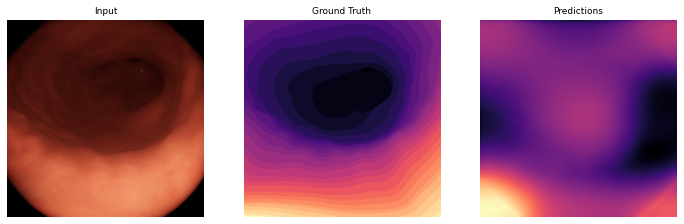

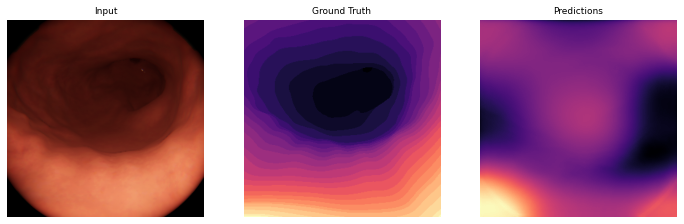

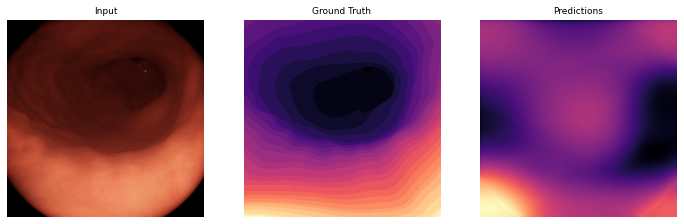

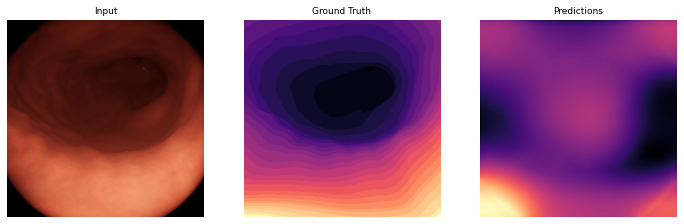

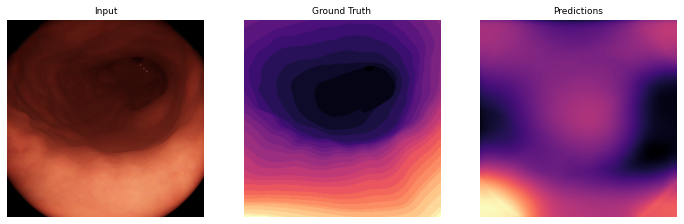

...

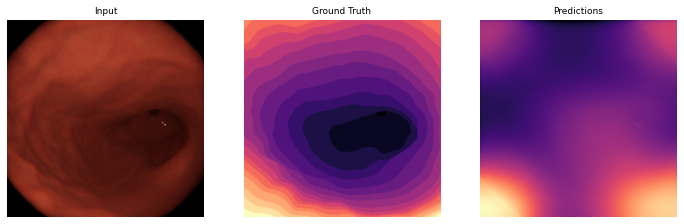

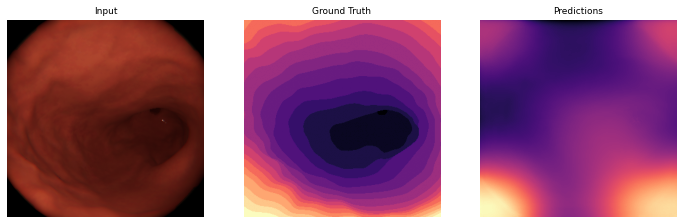

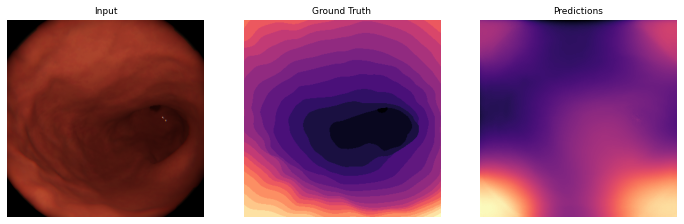

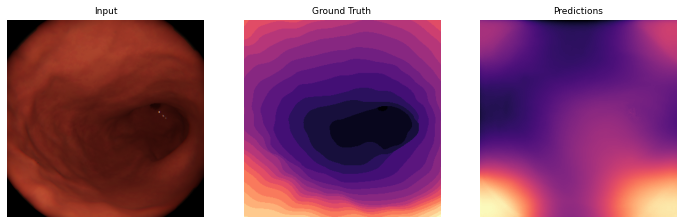

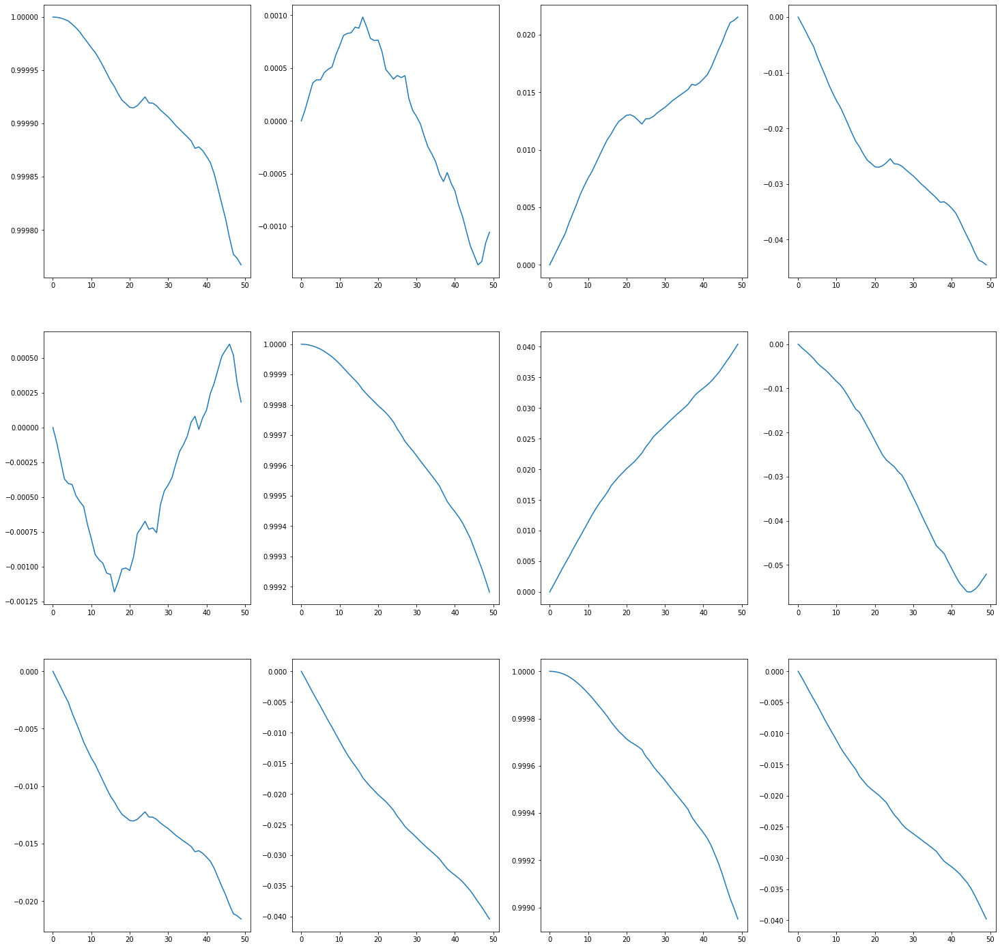

In [42]:
#Uncomment the configuration you want to run

run_config(epochs = 10, datasize=250)
#print("------------------------------------------------------------------------------------")
#run_config(epochs = 10, lr = 0.002, datasize=250)
#print("------------------------------------------------------------------------------------")
#run_config(epochs = 10, datasize=500)
#print("------------------------------------------------------------------------------------")
#run_config(epochs = 10, lr = 0.002, datasize=500)
#print("------------------------------------------------------------------------------------")

#run_config(epochs = 20, datasize=250)
#print("------------------------------------------------------------------------------------")
#run_config(epochs = 20, lr = 0.002, datasize=250)
#print("------------------------------------------------------------------------------------")
#run_config(epochs = 20, datasize=500)
#print("------------------------------------------------------------------------------------")
#run_config(epochs = 20, lr = 0.002, datasize=500) # problematic
#print("------------------------------------------------------------------------------------")
#run_config(epochs = 20, datasize=250, resnet = 50)

In [43]:
rmse_dict

{'s250_e10_lr0.0001_r18': 0.21874127095884682}

In [44]:
import json

with open("rmse.json", "w+") as rmseFile:
  json.dump(rmse_dict, rmseFile)

In [ ]:
"""
!rsync -pr ./checkpoints ../drive/MyDrive/bm582/hw1/
!rsync -pr ./results ../drive/MyDrive/bm582/hw1/
!rsync -pr ./vo_results ../drive/MyDrive/bm582/hw1/
!rsync -pr ./graphs ../drive/MyDrive/bm582/hw1/
!rsync -pr ./rmse.json ../drive/MyDrive/bm582/hw1/
"""